<a href="https://colab.research.google.com/github/Mattshanevdberg/FruitPunchAI_AIforSeals_FacialRecognition/blob/main/Seals_Recognition_Module_KFold_Evaluation_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Seal Recognition Module


## Requirements:
- Create a short cut of the data folder into your drive and edit the ds_path link

## Imports

In [ ]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow_hub as hub
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tqdm import tqdm
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import top_k_accuracy_score
from keras.models import Model
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns

CUSTOMIZE THIS PATH

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
ds_path = "/content/drive/MyDrive/AI for Seals Shared/01. Data/AI for Seals Data/Seal Data/SEALNET FILES FOR CHALLENGE/2020 Seals (by location)/4_Final_Training_Dataset"

## Loading data

Loading data into a dataframe

In [ ]:
imgs = []
labels = []
for seal in os.listdir(ds_path):
  for img in os.listdir(os.path.join(ds_path, seal)):
    imgs.append(os.path.join(ds_path, seal, img))
    labels.append(seal.split('_')[1])

original_df = pd.DataFrame(list(zip(labels, imgs)), columns=['seals','images'])

print(original_df.head())

   seals                                             images
0  Amino  /content/drive/MyDrive/AI for Seals Shared/01....
1  Amino  /content/drive/MyDrive/AI for Seals Shared/01....
2  Cowan  /content/drive/MyDrive/AI for Seals Shared/01....
3  Cowan  /content/drive/MyDrive/AI for Seals Shared/01....
4  Cowan  /content/drive/MyDrive/AI for Seals Shared/01....


In [ ]:
original_df

,seals,images
0,Amino,/content/drive/MyDrive/AI for Seals Shared/01....
1,Amino,/content/drive/MyDrive/AI for Seals Shared/01....
2,Cowan,/content/drive/MyDrive/AI for Seals Shared/01....
3,Cowan,/content/drive/MyDrive/AI for Seals Shared/01....
4,Cowan,/content/drive/MyDrive/AI for Seals Shared/01....
...,...,...
1173,Flor,/content/drive/MyDrive/AI for Seals Shared/01....
1174,Flor,/content/drive/MyDrive/AI for Seals Shared/01....
1175,Flor,/content/drive/MyDrive/AI for Seals Shared/01....
1176,Flor,/content/drive/MyDrive/AI for Seals Shared/01....


Filtering only seals with more than 5 samples

In [ ]:
count_df = original_df['seals'].value_counts().to_frame()
filtered_seals = count_df.loc[count_df['seals'] >= 5].index
df = original_df.loc[original_df['seals'].isin(filtered_seals)]

In [ ]:
df

,seals,images
14,Compass,/content/drive/MyDrive/AI for Seals Shared/01....
15,Compass,/content/drive/MyDrive/AI for Seals Shared/01....
16,Compass,/content/drive/MyDrive/AI for Seals Shared/01....
17,Compass,/content/drive/MyDrive/AI for Seals Shared/01....
18,Compass,/content/drive/MyDrive/AI for Seals Shared/01....
...,...,...
1173,Flor,/content/drive/MyDrive/AI for Seals Shared/01....
1174,Flor,/content/drive/MyDrive/AI for Seals Shared/01....
1175,Flor,/content/drive/MyDrive/AI for Seals Shared/01....
1176,Flor,/content/drive/MyDrive/AI for Seals Shared/01....


Dataset distribution

We got 74 seals with 5 or more samples...


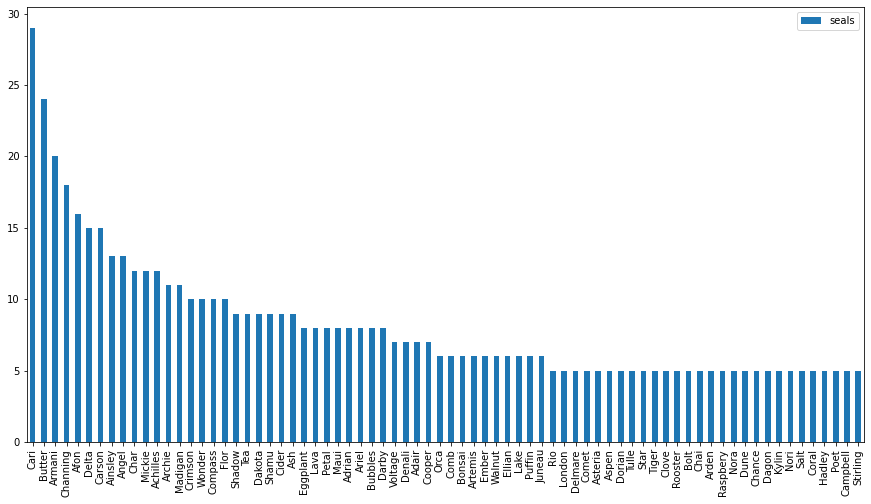

In [ ]:
filtered_count_df = df['seals'].value_counts().to_frame()
print("We got", len(filtered_count_df), "seals with 5 or more samples...")
filtered_count_df.plot.bar(y='seals', figsize=(15,8))

## Encoding labels



In [ ]:
# Encoding labels
encoder = LabelEncoder()
df['label'] = encoder.fit_transform(df['seals'])
num_classes = len(np.unique(df['label'].values))
print("Num classes", num_classes)

Num classes 74


<ipython-input-9-211bde1f15b7>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['label'] = encoder.fit_transform(df['seals'])


## Defining data pipeline

In [ ]:
def data_loader(ds, is_test=False):
  batch_size = 64
  ds = ds.map(load_img)
  if not is_test:
    ds = ds.map(augment_data)
    ds = ds.shuffle(len(ds)).repeat().batch(batch_size)
  return ds

def load_img(img, label):
  image = tf.io.read_file(img)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image, dtype=tf.float32)
  image = tf.image.resize(image, [224,224])
  image = image*255
  return  image, label

def augment_data(img,label):
  # Basic augmentations
  img_augmentation = Sequential(
      [layers.RandomRotation(factor=0.15),
      layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
      layers.RandomFlip(),
      layers.RandomContrast(factor=0.1)
      ])
  
  img = img_augmentation(img)

  return img,label


## Creating model

In [ ]:
def create_efficient_net():
  inputs = tf.keras.layers.Input(shape=(224, 224, 3))
  base_model =  tf.keras.applications.efficientnet_v2.EfficientNetV2B0(input_tensor=inputs, include_top=False, weights='imagenet')
  base_model.trainable = False
  x = tf.keras.layers.GlobalAveragePooling2D(name="avg_pool")(base_model.output)
  # x = tf.keras.layers.BatchNormalization()(x)
  for layer in base_model.layers[-3:]:
    layer.trainable = True

  # top_dropout_rate = 0.2
  # x = tf.keras.layers.Dropout(top_dropout_rate, name="dropout_1")(x)
  # x = tf.keras.layers.Dense(128, activation="relu", name="dense_1")(x)

  top_dropout_rate = 0.2
  x = tf.keras.layers.Dropout(top_dropout_rate, name="top_dropout")(x)
  outputs = tf.keras.layers.Dense(num_classes, activation="softmax", name="pred")(x)

  # Compile
  model = tf.keras.Model(inputs, outputs, name="EfficientNet")

  return model

## Training

In [ ]:
# K-fold cross validation
k_fold = StratifiedKFold(n_splits=5, shuffle = True, random_state = 100)

In [ ]:
# # Start training
# for i, (train_idx, test_idx) in tqdm(enumerate(k_fold.split(df, df.label))):
#     print(f"Starting training fold k={i}")
#     train_df = df.iloc[train_idx]
#     train_ds = tf.data.Dataset.from_tensor_slices((train_df['images'], train_df['label']))
#     train_ds = data_loader(train_ds)

#     validation_df = df.iloc[test_idx]
#     validation_ds = tf.data.Dataset.from_tensor_slices((validation_df['images'], validation_df['label']))
#     validation_ds = data_loader(validation_ds)

#     model = create_efficient_net()
#     model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath='.', save_best_only=True)
#     optimizer = tf.keras.optimizers.Adam(learning_rate=1e-3)
#     model.compile(
#         optimizer=optimizer, loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=["accuracy"]
#     )

#     # model.summary()

#     history = model.fit(train_ds,
#             validation_data = validation_ds, 
#             steps_per_epoch = 20,
#             validation_steps = 1, 
#             epochs= 10
#             )
    
#     tf.keras.models.save_model(model, f'/content/drive/MyDrive/pretrained_efficientnet_model_it_{i}_unfrozen_v2.h5')

0it [00:00, ?it/s]

Starting training fold k=0
Epoch 1/10
20/20 [==============================] - 16s 457ms/step - loss: 3.2419 - accuracy: 0.4109 - val_loss: 2.3562 - val_accuracy: 0.5781
Epoch 2/10
20/20 [==============================] - 5s 251ms/step - loss: 1.4705 - accuracy: 0.8492 - val_loss: 1.3641 - val_accuracy: 0.7656
Epoch 3/10
20/20 [==============================] - 5s 264ms/step - loss: 0.6286 - accuracy: 0.9688 - val_loss: 0.7361 - val_accuracy: 0.9062
Epoch 4/10
20/20 [==============================] - 5s 266ms/step - loss: 0.3060 - accuracy: 0.9891 - val_loss: 0.4788 - val_accuracy: 0.8906
Epoch 5/10
20/20 [==============================] - 5s 246ms/step - loss: 0.1682 - accuracy: 0.9953 - val_loss: 0.4779 - val_accuracy: 0.8750
Epoch 6/10
20/20 [==============================] - 6s 284ms/step - loss: 0.1152 - accuracy: 0.9984 - val_loss: 0.3518 - val_accuracy: 0.8906
Epoch 7/10
20/20 [==============================] - 5s 248ms/step - loss: 0.0823 - accuracy: 0.9984 - val_loss: 0.4545 -

1it [01:32, 92.27s/it]

Starting training fold k=1
Epoch 1/10
20/20 [==============================] - 15s 377ms/step - loss: 3.2069 - accuracy: 0.4180 - val_loss: 2.1770 - val_accuracy: 0.6406
Epoch 2/10
20/20 [==============================] - 5s 241ms/step - loss: 1.4050 - accuracy: 0.8570 - val_loss: 1.2979 - val_accuracy: 0.7656
Epoch 3/10
20/20 [==============================] - 5s 240ms/step - loss: 0.6076 - accuracy: 0.9695 - val_loss: 0.8861 - val_accuracy: 0.8438
Epoch 4/10
20/20 [==============================] - 5s 274ms/step - loss: 0.2910 - accuracy: 0.9852 - val_loss: 0.6592 - val_accuracy: 0.9062
Epoch 5/10
20/20 [==============================] - 5s 243ms/step - loss: 0.1685 - accuracy: 0.9969 - val_loss: 0.6270 - val_accuracy: 0.8906
Epoch 6/10
20/20 [==============================] - 5s 250ms/step - loss: 0.1101 - accuracy: 0.9969 - val_loss: 0.6250 - val_accuracy: 0.8594
Epoch 7/10
20/20 [==============================] - 5s 259ms/step - loss: 0.0776 - accuracy: 1.0000 - val_loss: 0.5573 -

2it [02:35, 74.93s/it]

Starting training fold k=2
Epoch 1/10
20/20 [==============================] - 15s 322ms/step - loss: 3.1997 - accuracy: 0.4406 - val_loss: 2.2944 - val_accuracy: 0.6562
Epoch 2/10
20/20 [==============================] - 5s 273ms/step - loss: 1.4042 - accuracy: 0.8656 - val_loss: 1.2879 - val_accuracy: 0.8125
Epoch 3/10
20/20 [==============================] - 5s 242ms/step - loss: 0.6152 - accuracy: 0.9531 - val_loss: 0.7257 - val_accuracy: 0.8750
Epoch 4/10
20/20 [==============================] - 5s 242ms/step - loss: 0.3015 - accuracy: 0.9805 - val_loss: 0.6178 - val_accuracy: 0.9062
Epoch 5/10
20/20 [==============================] - 5s 274ms/step - loss: 0.1741 - accuracy: 0.9969 - val_loss: 0.5982 - val_accuracy: 0.8906
Epoch 6/10
20/20 [==============================] - 5s 236ms/step - loss: 0.1196 - accuracy: 0.9961 - val_loss: 0.6000 - val_accuracy: 0.8750
Epoch 7/10
20/20 [==============================] - 5s 262ms/step - loss: 0.0869 - accuracy: 0.9992 - val_loss: 0.3291 -

3it [04:07, 82.85s/it]

Starting training fold k=3
Epoch 1/10
20/20 [==============================] - 14s 333ms/step - loss: 3.2164 - accuracy: 0.4359 - val_loss: 2.1092 - val_accuracy: 0.6250
Epoch 2/10
20/20 [==============================] - 6s 287ms/step - loss: 1.4250 - accuracy: 0.8625 - val_loss: 1.4356 - val_accuracy: 0.7656
Epoch 3/10
20/20 [==============================] - 5s 245ms/step - loss: 0.6095 - accuracy: 0.9656 - val_loss: 0.8295 - val_accuracy: 0.8281
Epoch 4/10
20/20 [==============================] - 5s 259ms/step - loss: 0.2930 - accuracy: 0.9852 - val_loss: 0.7894 - val_accuracy: 0.8281
Epoch 5/10
20/20 [==============================] - 5s 267ms/step - loss: 0.1719 - accuracy: 0.9937 - val_loss: 0.5448 - val_accuracy: 0.8906
Epoch 6/10
20/20 [==============================] - 5s 248ms/step - loss: 0.1106 - accuracy: 0.9984 - val_loss: 0.4941 - val_accuracy: 0.9062
Epoch 7/10
20/20 [==============================] - 6s 284ms/step - loss: 0.0831 - accuracy: 0.9969 - val_loss: 0.3956 -

4it [05:11, 75.40s/it]

Starting training fold k=4
Epoch 1/10
20/20 [==============================] - 15s 322ms/step - loss: 3.2900 - accuracy: 0.4258 - val_loss: 2.2954 - val_accuracy: 0.6250
Epoch 2/10
20/20 [==============================] - 5s 257ms/step - loss: 1.4228 - accuracy: 0.8570 - val_loss: 1.2390 - val_accuracy: 0.7969
Epoch 3/10
20/20 [==============================] - 5s 254ms/step - loss: 0.6254 - accuracy: 0.9664 - val_loss: 0.7815 - val_accuracy: 0.8750
Epoch 4/10
20/20 [==============================] - 5s 238ms/step - loss: 0.2997 - accuracy: 0.9867 - val_loss: 0.5711 - val_accuracy: 0.9062
Epoch 5/10
20/20 [==============================] - 6s 278ms/step - loss: 0.1662 - accuracy: 0.9961 - val_loss: 0.5886 - val_accuracy: 0.8594
Epoch 6/10
20/20 [==============================] - 5s 242ms/step - loss: 0.1180 - accuracy: 0.9992 - val_loss: 0.4742 - val_accuracy: 0.8750
Epoch 7/10
20/20 [==============================] - 5s 238ms/step - loss: 0.0850 - accuracy: 0.9961 - val_loss: 0.3728 -

5it [06:43, 80.64s/it]


This represents the results if we also use the dense layer for the classification (instead of similarity)

In [ ]:
all_k_1 = []
all_k_5 = []
for i, (train_idx, test_idx) in tqdm(enumerate(k_fold.split(df, df.label))):
  # load model
  saved_model = tf.keras.models.load_model(f'/content/drive/MyDrive/pretrained_efficientnet_model_it_{i}_unfrozen.h5')

  print(f"Starting evaluation fold k={i}")
  test_df = df.iloc[test_idx]
  test_ds = tf.data.Dataset.from_tensor_slices((test_df['images'], test_df['label']))
  test_ds = data_loader(test_ds, is_test=True)

  y_trues = []
  y_preds = []
  for image,label in test_ds.as_numpy_iterator():
    #Add batch dim
    image =  np.expand_dims(image, axis=0)

    y_pred = saved_model.predict(image,verbose=0)
    y_pred = np.squeeze(y_pred,0)

    y_preds.append(y_pred)
    y_trues.append(label)

  k1_acc = top_k_accuracy_score(y_trues, y_preds, k=1)
  k5_acc = top_k_accuracy_score(y_trues, y_preds, k=5)
  print(f"Top K-1 accuracy for model iteration {i}", k1_acc)
  print(f"Top K-5 accuracy for model iteration {i}", k5_acc)

  all_k_1.append(k1_acc)
  all_k_5.append(k5_acc)

print(f"Average Top K-1 accuracy", np.mean(all_k_1))
print(f"Average Top K-5 accuracy", np.mean(all_k_5))

0it [00:00, ?it/s]

Starting evaluation fold k=0


1it [00:35, 35.36s/it]

Top K-1 accuracy for model iteration 0 0.8934426229508197
Top K-5 accuracy for model iteration 0 0.9836065573770492
Starting evaluation fold k=1


2it [01:00, 29.18s/it]

Top K-1 accuracy for model iteration 1 0.9098360655737705
Top K-5 accuracy for model iteration 1 0.9918032786885246
Starting evaluation fold k=2


3it [01:25, 27.55s/it]

Top K-1 accuracy for model iteration 2 0.8925619834710744
Top K-5 accuracy for model iteration 2 0.9669421487603306
Starting evaluation fold k=3


4it [02:14, 35.87s/it]

Top K-1 accuracy for model iteration 3 0.8842975206611571
Top K-5 accuracy for model iteration 3 0.9834710743801653
Starting evaluation fold k=4


5it [02:37, 31.49s/it]

Top K-1 accuracy for model iteration 4 0.8842975206611571
Top K-5 accuracy for model iteration 4 0.9752066115702479
Average Top K-1 accuracy 0.8928871426635958
Average Top K-5 accuracy 0.9802059341552635


## Close-set evaluation

### Load whole training/testing dataframe as a dataset

In [ ]:
#Prepare gallery images
complete_ds = tf.data.Dataset.from_tensor_slices((df['images'], df['seals']))
complete_ds = data_loader(complete_ds, is_test=True)

img_list = []
label_list = []

for img, label in complete_ds:
  img_list.append(tf.expand_dims(input=img, axis=0))
  label_list.append(label.numpy().decode("utf-8"))

label_array = np.array(label_list)

### Split embeddings in probe and gallery sets, compute similarity and metrics

In [ ]:
df_results = pd.DataFrame([], columns = ["Model", "Fold", "Metric", "Score"])

# K-fold cross validation
k_fold = StratifiedKFold(n_splits=5, shuffle = True, random_state = 100)
model = create_efficient_net()

for i, (train_idx, test_idx) in tqdm(enumerate(k_fold.split(df, df.label))):
  # load model weights
  model.load_weights(f'/content/drive/MyDrive/pretrained_efficientnet_model_it_{i}_unfrozen.h5')
  # Create embedding model (by dropping last layer)
  embedding_model = Model(inputs=model.input, outputs=model.layers[-2].output)

  embeddings = []
  for img in img_list:
    embedding = embedding_model(img)
    embedding = tf.squeeze(embedding).numpy()
    embeddings.append(embedding)

  df_results_tmp = pd.DataFrame([], columns = ["Model", "Fold", "Metric", "Score"])

  X_train = np.array(embeddings)[train_idx]
  X_test = np.array(embeddings)[test_idx]
  y_train = label_array[train_idx]
  y_test = label_array[test_idx]

  # euclidean_similarities = np.zeros((len(X_test), len(X_train)))
  # for i, x_te in enumerate(X_test):
  #   for j, x_tr in enumerate(X_train):
  #     dist = np.linalg.norm(x_te - x_tr)
  #     euclidean_similarities[i,j] = 1/(1+dist) 
  # all_similarity_results = np.array(all_similarity_results)
  euclidean_similarities = cosine_similarity(X_test, X_train)
  # euclidean_similarities = all_similarity_results[test_idx, train_idx]

  for N in [1, 3, 5]:
      top_N_classes = np.zeros((len(X_test),N), dtype = label_array.dtype)

      for i, row in enumerate(np.argsort(euclidean_similarities, axis=1)[:, -N:]):
          top_N_classes[i] = y_train[row]

      y_pred_df = pd.DataFrame(top_N_classes)#.mode(axis=1).values[:,0]
      y_pred = []
      for row, y_t in zip(y_pred_df.values, y_test):
          if(y_t in row):
              y_pred.append(y_t)
          else:
              y_pred.append(row[0])
      y_pred = np.array(y_pred)

      acc = accuracy_score(y_test, y_pred)
      prec = precision_score(y_test, y_pred, average = "macro", zero_division = 0)
      rec = recall_score(y_test, y_pred, average = "macro", zero_division = 0)
      f1 = f1_score(y_test, y_pred, average = "macro", zero_division = 0)
      cmat = confusion_matrix(y_test, y_pred)

      model_name = "EfficientNET + Cosine Similarity Top " + str(N)

      fold = i
      results = []
      for metric_name, metric in zip(["Accuracy", "Precision", "Recall", "F1-Score"],[acc, prec, rec, f1]):
          results.append([model_name, fold, metric_name, metric])
      df_tmp = pd.DataFrame(results, columns = ["Model", "Fold", "Metric", "Score"])

      df_results_tmp = pd.concat([df_results_tmp, df_tmp])
  df_results = pd.concat([df_results, df_results_tmp])

24274472/24274472 [==============================] - 0s 0us/step


5it [07:47, 93.53s/it]


### Plot metrics

In [ ]:
model_mask = [("EfficientNET + Cosine" in res_model) for res_model in df_results["Model"]]

In [ ]:
df_results[model_mask*(df_results["Metric"]=="Accuracy")*[("Top 1" in res_model) for res_model in df_results["Model"]]].describe()

,Score
count,5.000000
mean,0.864842
std,0.019521
min,0.842975
25%,0.851240
50%,0.859504
75%,0.885246
max,0.885246


In [ ]:
df_results[model_mask*(df_results["Metric"]=="Accuracy")*[("Top 5" in res_model) for res_model in df_results["Model"]]].describe()

,Score
count,5.000000
mean,0.960412
std,0.015975
min,0.942149
25%,0.950413
50%,0.958678
75%,0.967213
max,0.983607


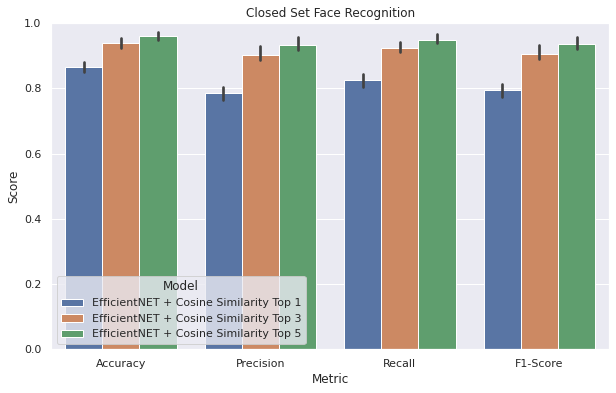

In [ ]:
sns.set_theme()

plt.figure(figsize=(10,6))
plt.title("Closed Set Face Recognition")
sns.barplot(data = df_results[model_mask], x = "Metric", y = "Score", hue = "Model")
plt.ylim(0,1)
plt.show()

### Print similarity results
These currently are done using only the last model (trained on fold 5)

0
[0 1 2 3 4 5 6 7]


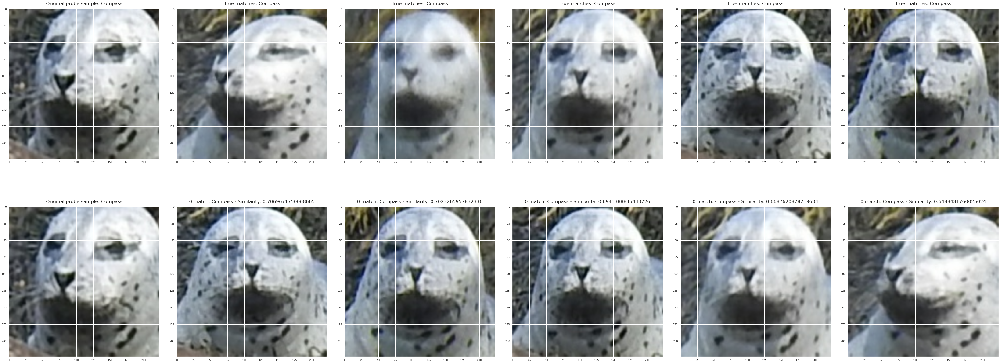

1
[0 1 2 3 4 5 6 7]


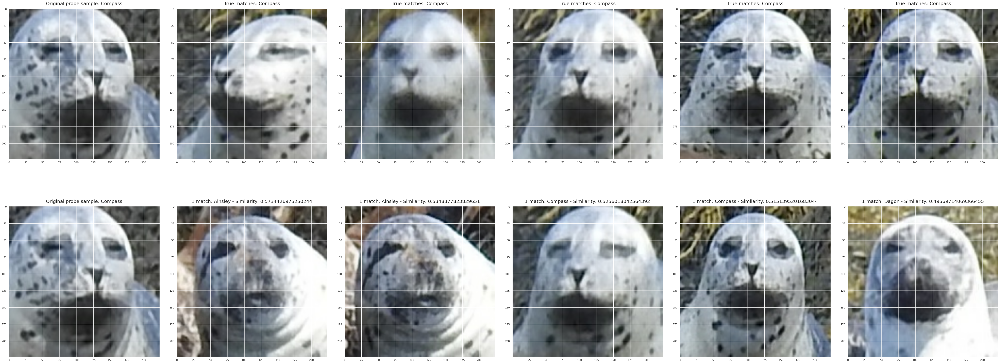

2
[ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31]


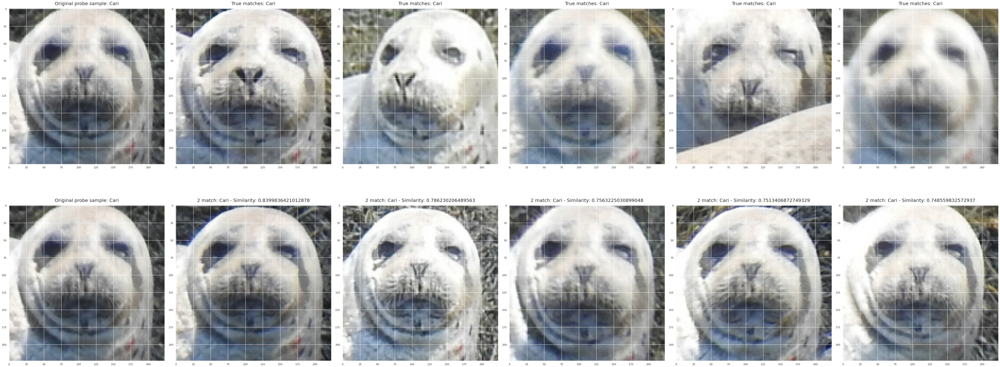

3
[ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31]


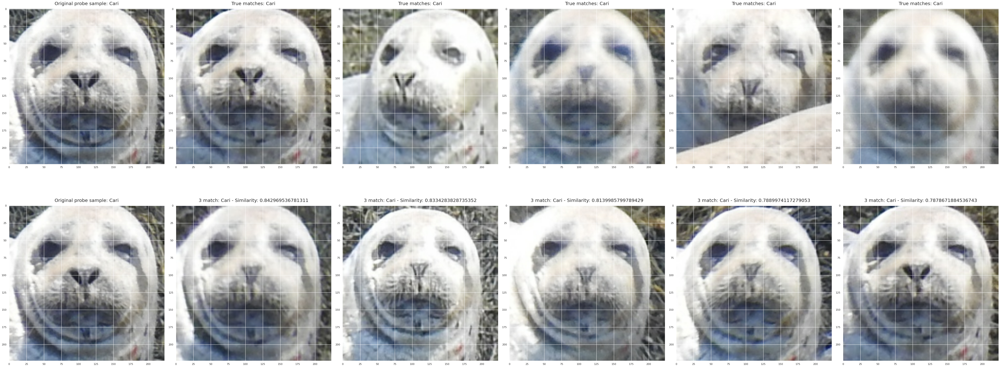

4
[ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31]


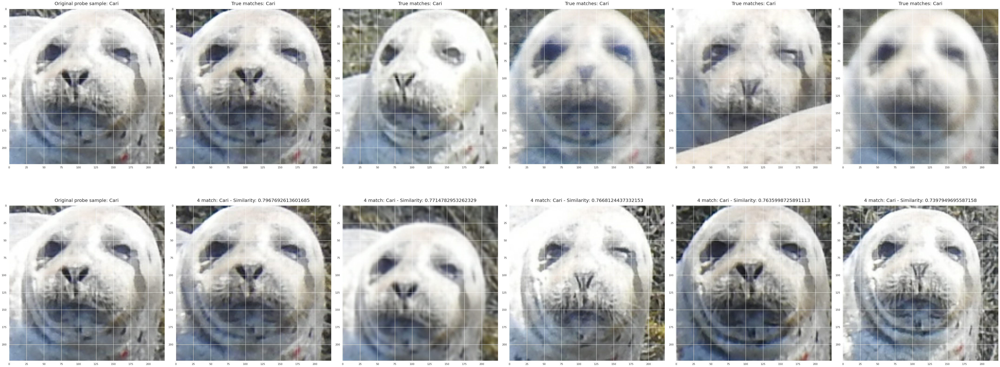

In [ ]:
sns.set_theme(None)
y_train = label_array[train_idx]
y_test = label_array[test_idx]
img_train = np.array(img_list)[train_idx]
img_test = np.array(img_list)[test_idx]

for i, similarities in enumerate(euclidean_similarities[:5]):
  print(i)
  top_5_idx = np.argsort(similarities)[::-1][:5]
  top_5_similarities =  [similarities[i] for i in top_5_idx]
  top_5_imgs =  [tf.squeeze(img_train[i]).numpy()/255 for i in top_5_idx]
  top_5_labels = [y_train[i] for i in top_5_idx]

  f, axarr = plt.subplots(2,6, figsize=(60, 25))

  probe_image = tf.squeeze(img_test[i]).numpy()/255

  true_indices = np.arange(len(y_train))[y_train==y_test[i]]
  print(true_indices)

  true_imgs =  [tf.squeeze(img_train[i]).numpy()/255 for i in true_indices]
  true_labels = [y_train[i] for i in true_indices]
  
  axarr[0,0].imshow(probe_image)
  axarr[0,0].set_title(f"Original probe sample: {y_test[i]}", fontsize=20, pad=15)
  for j in range(min(len(true_indices), 5)):
    axarr[0,j+1].imshow(true_imgs[j])
    axarr[0,j+1].set_title(f"True matches: {true_labels[j]}", fontsize=20, pad=15)

  axarr[1,0].imshow(probe_image)
  axarr[1,0].set_title(f"Original probe sample: {y_test[i]}", fontsize=20, pad=15)
  for j in range(5):
    axarr[1,j+1].imshow(top_5_imgs[j])
    axarr[1,j+1].set_title(f"{i} match: {top_5_labels[j]} - Similarity: {top_5_similarities[j]}", fontsize=20, pad=15)
  plt.tight_layout()
  plt.show()

## Close-set evaluation of unseen seals

### Creating dataset of UNSEEN seals

This are seals that have 3 or 4 images :)

In [ ]:
# Filter dataset to seals with 3 or 4 images
count_df = original_df['seals'].value_counts().to_frame()
filtered_seals_v2 = count_df.loc[(count_df['seals'] > 2)*(count_df['seals'] < 5)].index
df_v2 = original_df.loc[original_df['seals'].isin(filtered_seals_v2)]

print("Number of seals", len(df_v2['seals'].value_counts().to_frame()))
print("Number of test samples", len(df_v2))

Number of seals 64
Number of test samples 215


In [ ]:
#Load dataframe of unseen seals as a dataset
unseen_ds = tf.data.Dataset.from_tensor_slices((df_v2['images'], df_v2['seals']))
unseen_ds = data_loader(unseen_ds, is_test=True)

unseen_img_list = []
unseen_label_list = []

for img, label in unseen_ds:
  unseen_img_list.append(tf.expand_dims(input=img, axis=0))
  unseen_label_list.append(label.numpy().decode("utf-8"))

unseen_label_array = np.array(unseen_label_list)

### Splitting dataset in probe and gallery sets

In [ ]:
# Getting train and test indices for the new set 
gallery_idx, probe_idx = train_test_split(np.arange(len(unseen_img_list)), test_size=0.33, random_state=42, stratify = unseen_label_array)

### Perform evaluation metrics

In [ ]:
df_results = pd.DataFrame([], columns = ["Model", "Fold", "Metric", "Score"]) 

# K-fold cross validation
model = create_efficient_net()

for fold_i in range(5): #We iterate over all the 5 trained iterations of the model
  # load model weights
  model.load_weights(f'/content/drive/MyDrive/pretrained_efficientnet_model_it_{fold_i}_unfrozen.h5')
  # Create embedding model (by dropping last layer)
  embedding_model = Model(inputs=model.input, outputs=model.layers[-2].output)

  embeddings = []
  for img in tqdm(unseen_img_list):
    embedding = embedding_model(img)
    embedding = tf.squeeze(embedding).numpy()
    embeddings.append(embedding)

  df_results_tmp = pd.DataFrame([], columns = ["Model", "Fold", "Metric", "Score"])
  gallery_embeddings = np.array(embeddings)[gallery_idx]
  probe_embeddings = np.array(embeddings)[probe_idx]
  gallery_labels = unseen_label_array[gallery_idx]
  probe_labels = unseen_label_array[probe_idx]

  # euclidean_similarities = np.zeros((len(probe_embeddings), len(gallery_embeddings)))
  # for i, x_te in enumerate(probe_embeddings):
  #   for j, x_tr in enumerate(gallery_embeddings):
  #     dist = np.linalg.norm(x_te - x_tr)
  #     euclidean_similarities[i,j] = 1/(1+dist) 
  euclidean_similarities = cosine_similarity(probe_embeddings, gallery_embeddings)

  for N in [1, 3, 5]:
      top_N_classes = np.zeros((len(probe_embeddings),N), dtype = gallery_labels.dtype)

      for i, row in enumerate(np.argsort(euclidean_similarities, axis=1)[:, -N:]):
          top_N_classes[i] = gallery_labels[row]

      y_pred_df = pd.DataFrame(top_N_classes)#.mode(axis=1).values[:,0]
      y_pred = []
      for row, y_t in zip(y_pred_df.values, probe_labels):
          if(y_t in row):
              y_pred.append(y_t)
          else:
              y_pred.append(row[0])
      y_pred = np.array(y_pred)

      acc = accuracy_score(probe_labels, y_pred)
      prec = precision_score(probe_labels, y_pred, average = "macro", zero_division = 0)
      rec = recall_score(probe_labels, y_pred, average = "macro", zero_division = 0)
      f1 = f1_score(probe_labels, y_pred, average = "macro", zero_division = 0)
      cmat = confusion_matrix(probe_labels, y_pred)

      model_name = "EfficientNETv2 + Cosine Similarity Top " + str(N)

      fold = fold_i
      results = []
      for metric_name, metric in zip(["Accuracy", "Precision", "Recall", "F1-Score"],[acc, prec, rec, f1]):
          results.append([model_name, fold, metric_name, metric])
      df_tmp = pd.DataFrame(results, columns = ["Model", "Fold", "Metric", "Score"])

      df_results_tmp = pd.concat([df_results_tmp, df_tmp])
  df_results = pd.concat([df_results, df_results_tmp])

100%|██████████| 215/215 [00:34<00:00,  6.22it/s]


### Plotting performance results

In [ ]:
model_mask = [("EfficientNETv2 + Cosine" in res_model) for res_model in df_results["Model"]]

In [ ]:
df_results[model_mask*(df_results["Metric"]=="Accuracy")*[("Top 1" in res_model) for res_model in df_results["Model"]]].describe()

,Score
count,5.000000
mean,0.757746
std,0.018364
min,0.746479
25%,0.746479
50%,0.746479
75%,0.760563
max,0.788732


In [ ]:
df_results[model_mask*(df_results["Metric"]=="Accuracy")*[("Top 5" in res_model) for res_model in df_results["Model"]]].describe()

,Score
count,5.000000
mean,0.904225
std,0.011784
min,0.887324
25%,0.901408
50%,0.901408
75%,0.915493
max,0.915493


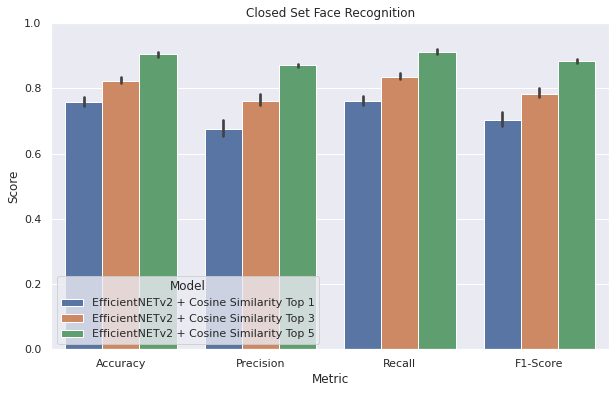

In [ ]:
sns.set_theme()

plt.figure(figsize=(10,6))
plt.title("Closed Set Face Recognition")
model_mask = [("EfficientNETv2" in res_model) for res_model in df_results["Model"]]
sns.barplot(data = df_results[model_mask], x = "Metric", y = "Score", hue = "Model")
plt.ylim(0,1)
plt.show()

### Prompting most similar images
These currently are done using only the last model (trained on fold 5)

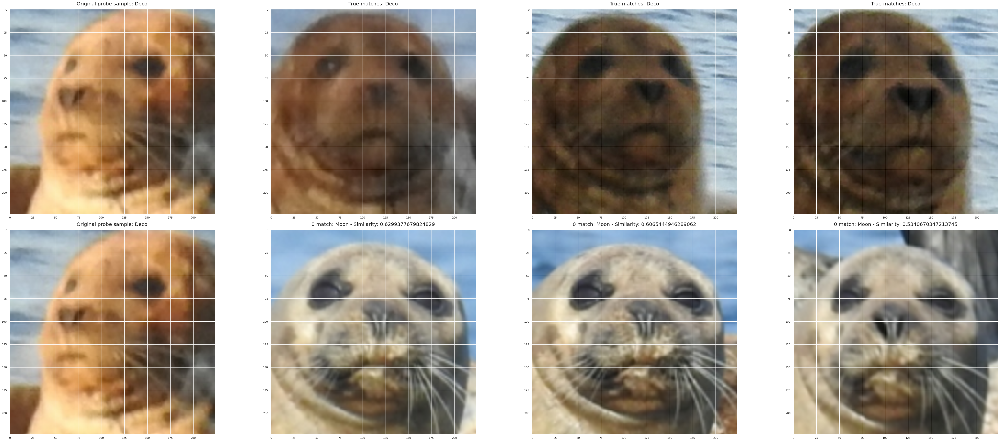

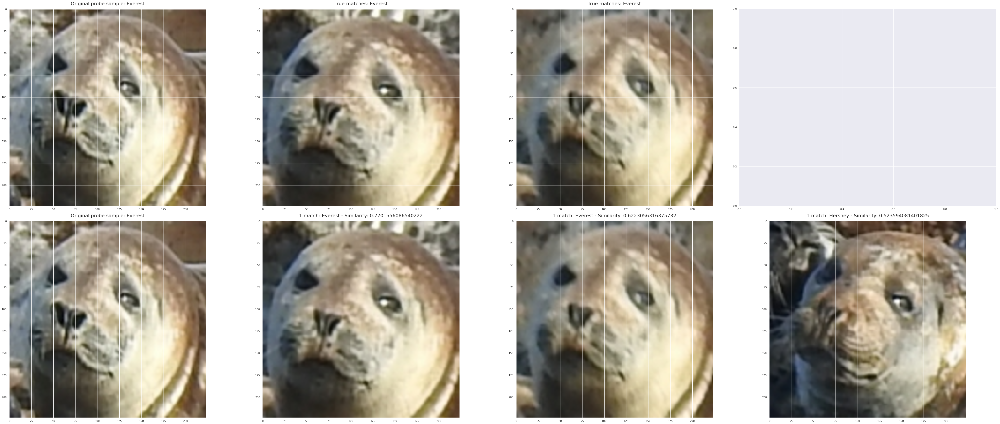

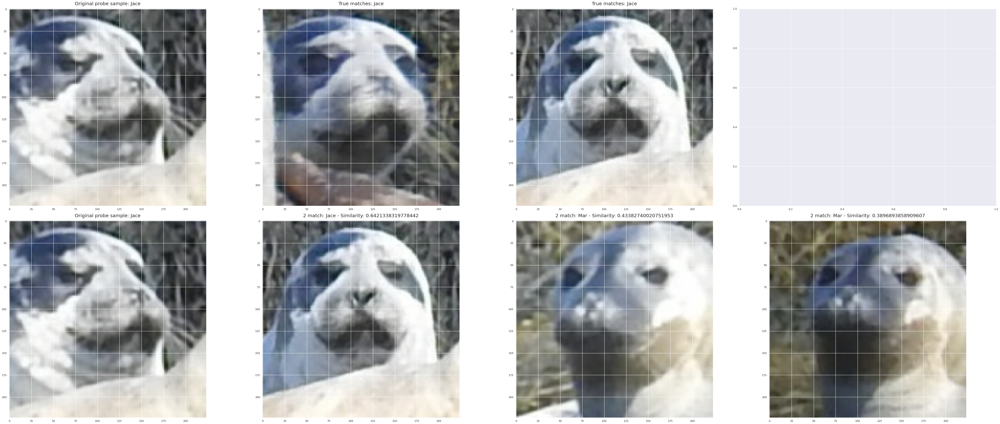

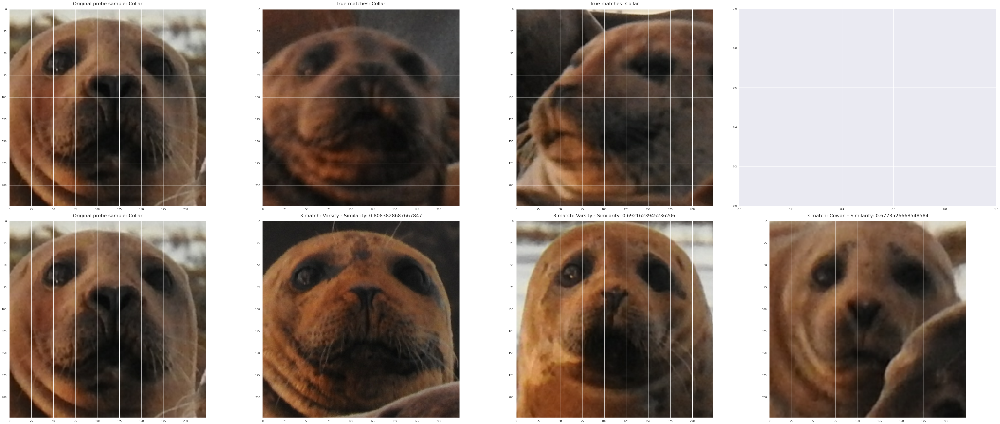

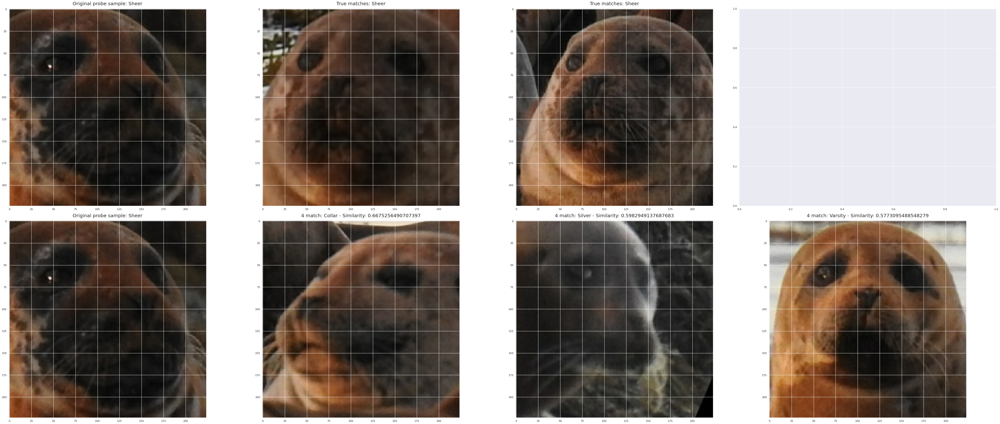

In [ ]:
# Visualize most similar images
sns.set_theme(None)
gallery_labels = unseen_label_array[gallery_idx]
probe_labels = unseen_label_array[probe_idx]
gallery_imgs = np.array(unseen_img_list)[gallery_idx]
probe_imgs = np.array(unseen_img_list)[probe_idx]

for i, similarities in enumerate(euclidean_similarities[:5]):
  #print(i)
  top_5_idx = np.argsort(similarities)[::-1][:3]
  top_5_similarities =  [similarities[i] for i in top_5_idx]
  top_5_imgs =  [tf.squeeze(gallery_imgs[i]).numpy()/255 for i in top_5_idx]
  top_5_labels = [gallery_labels[i] for i in top_5_idx]

  f, axarr = plt.subplots(2,4, figsize=(60, 25))

  probe_image = tf.squeeze(probe_imgs[i]).numpy()/255

  true_indices = np.arange(len(gallery_labels))[gallery_labels==probe_labels[i]]
  #print(true_indices)

  true_imgs =  [tf.squeeze(gallery_imgs[i]).numpy()/255 for i in true_indices]
  true_labels = [gallery_labels[i] for i in true_indices]
  
  axarr[0,0].imshow(probe_image)
  axarr[0,0].set_title(f"Original probe sample: {probe_labels[i]}", fontsize=20, pad=15)
  for j in range(min(len(true_indices), 3)):
    axarr[0,j+1].imshow(true_imgs[j])
    axarr[0,j+1].set_title(f"True matches: {true_labels[j]}", fontsize=20, pad=15)

  axarr[1,0].imshow(probe_image)
  axarr[1,0].set_title(f"Original probe sample: {probe_labels[i]}", fontsize=20, pad=15)
  for j in range(3):
    axarr[1,j+1].imshow(top_5_imgs[j])
    axarr[1,j+1].set_title(f"{i} match: {top_5_labels[j]} - Similarity: {top_5_similarities[j]}", fontsize=20, pad=15)
  plt.tight_layout()
  plt.show()